In [1]:
import matplotlib
#matplotlib.use('TkAgg')
%matplotlib inline

import pylab as PL
import random as RD
import scipy as SP

RD.seed()

width = 100
height = 100
initProb = 0.5
empty, tree, fire, char = range(4)

def init():
    global time, config, nextConfig

    time = 0

    config = SP.zeros([height, width])
    for x in range(width):
        for y in range(height):
            if RD.random() < initProb:
                state = tree
            else:
                state = empty
            config[y, x] = state
    config[height//2, width//2] = fire

    nextConfig = SP.zeros([height, width])

def draw():
    PL.cla()
    PL.pcolor(config, vmin = 0, vmax = 3, cmap = PL.cm.binary)
    PL.axis('image')
    PL.title('t = ' + str(time))

def step():
    global time, config, nextConfig

    time += 1

    for x in range(width):
        for y in range(height):
            state = config[y, x]
            if state == fire:
                state = char
            elif state == tree:
                for dx in range(-1, 2):
                    for dy in range(-1, 2):
                        if config[(y+dy)%height, (x+dx)%width] == fire:
                            state = fire
            nextConfig[y, x] = state

    config, nextConfig = nextConfig, config

#import pycxsimulator
#pycxsimulator.GUI().start(func=[init,draw,step])

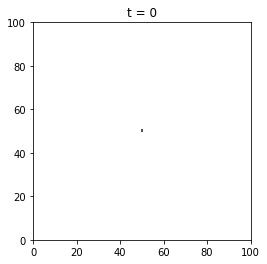

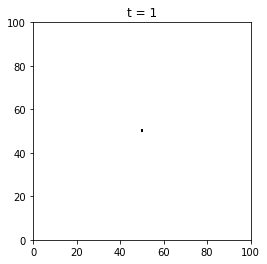

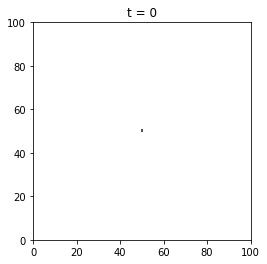

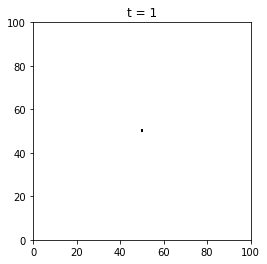

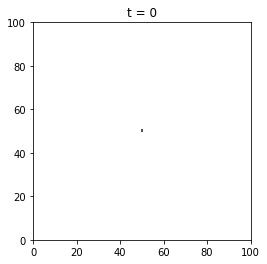

...

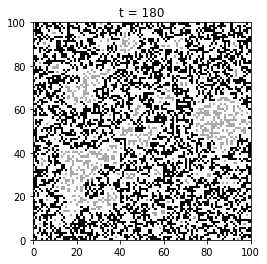

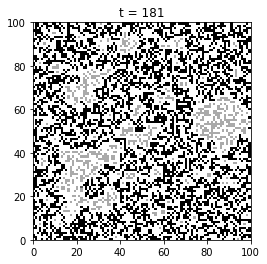

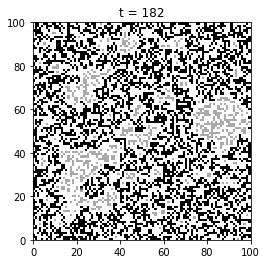

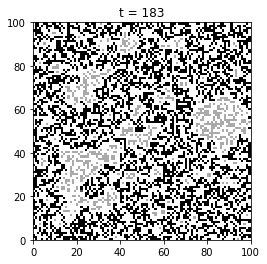

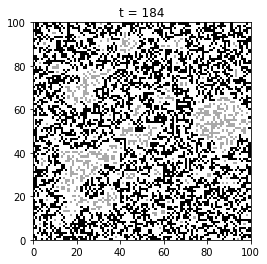

In [ ]:
import numpy as np

probs = np.linspace(0,1,num=30)

burned = []
times = []


for p in probs:
    burns = []
    timess = []
    initProb = p
    for j in range(10):
        init()
        for i in range(200):
            draw()
            step()
            if np.all(config==nextConfig):
                timess.append(time)
                break
        burns.append((config ==3).sum())
    burned.append(np.mean(burns))
    times.append(np.mean(timess))

In [ ]:
PL.plot(probs,burned)
PL.xlabel("Probability")
PL.ylabel("Burned Area")
PL.show()

PL.plot(probs,times)
PL.xlabel("Probability")
PL.ylabel("Time Burning Stopped")
PL.show()